In [1]:
import os
import math
import pickle
import numpy as np

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import precision_recall_curve, roc_curve
from utils import exponential_moving_average, predict

In [2]:
result_dir = "."
result_file_name = "results.pkl"

In [3]:
with open(os.path.join(result_dir, result_file_name), "rb") as f:
    results = pickle.load(f)
    f.close()

In [4]:
results

{'weights': {0.001: {'gd': array([-0.40045765,  0.6729936 , -0.09060964, -0.28449586,  0.691703  ,
           0.82468808,  0.4402986 , -0.19782353, -0.9369512 , -0.20480903,
           0.06542662, -0.37650605, -0.45430584, -0.25771105, -0.54542615,
           0.17671256]),
   'Adam': array([  3.47524367,  -8.58817621,   2.6762807 ,   5.29284064,
           13.38745551,   9.7114503 ,  -9.02927002,  -7.79608669,
          -19.75731001,   3.83194392,  -2.04358547,  -0.12832827,
            1.23231936,   0.97236827, -20.01653217,  10.95551973]),
   'Momentum': array([-0.40052324,  0.67300603, -0.09069627, -0.28449445,  0.69160845,
           0.82466161,  0.44040204, -0.19794104, -0.93662275, -0.20483199,
           0.06547742, -0.37656776, -0.45433984, -0.2577598 , -0.54538422,
           0.17670018]),
   'Adagrad': array([  4.03194778,  -7.80866691,   2.12182273,   5.08712417,
           12.86777266,   9.92066321,  -9.28509046,  -7.53771626,
          -19.78958806,   3.90875141,  -1.96278

In [5]:
list(results.keys())

['weights',
 'min_val_cost_weights',
 'max_val_acc_weights',
 'train_cost',
 'train_acc',
 'val_cost',
 'val_acc',
 'time_epoch',
 'timestamp_epoch',
 'wolf_II',
 'goldstein']

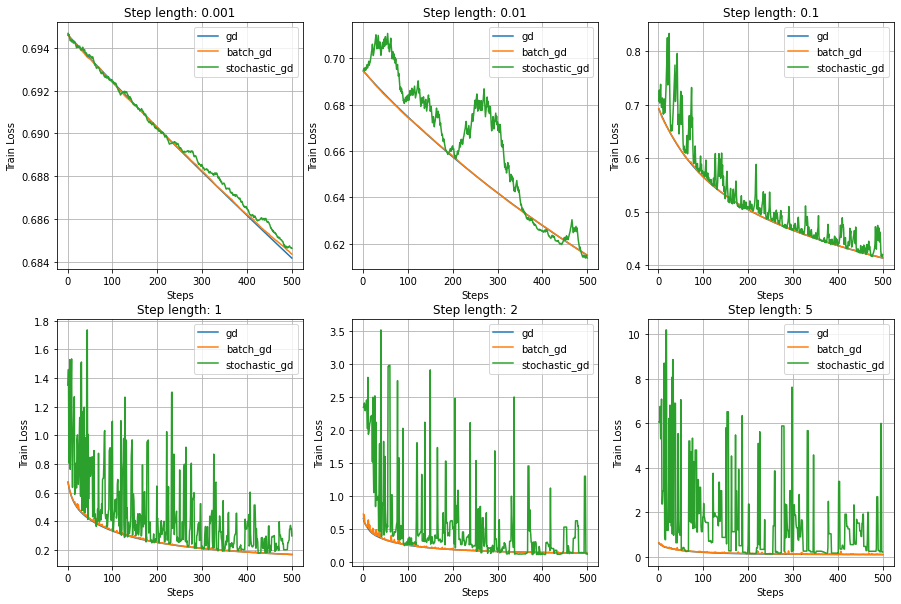

In [6]:
#plt.figure(facecolor='w')
#plt.plot(np.arange(1, 501), results["train_cost"]["gd"][:500], label="Gradient Descent")
#plt.plot(np.arange(1, 501), results["train_cost"]["batch_gd"][:500], label="Batch Gradient Descent")
#plt.plot(np.arange(1, 501), results["train_cost"]["stochastic_gd"][:500], label="Stochastic Gradient Descent")
#plt.xlabel("Steps")
#plt.ylabel("Loss")
#plt.legend()
#plt.grid()
#
#plt.show()

fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    x = np.arange(1, 501)
    y_1 = results["train_cost"][step_length]["gd"][:500]
    y_2 = results["train_cost"][step_length]["batch_gd"][:500]
    y_3 = results["train_cost"][step_length]["stochastic_gd"][:500]
    ax.plot(x, y_1, label="gd")
    ax.plot(x, y_2, label="batch_gd")
    ax.plot(x, y_3, label="stochastic_gd")
    ax.set_xlabel("Steps")
    ax.set_ylabel("Train Loss")
    ax.grid()
    ax.legend()
    i += 1

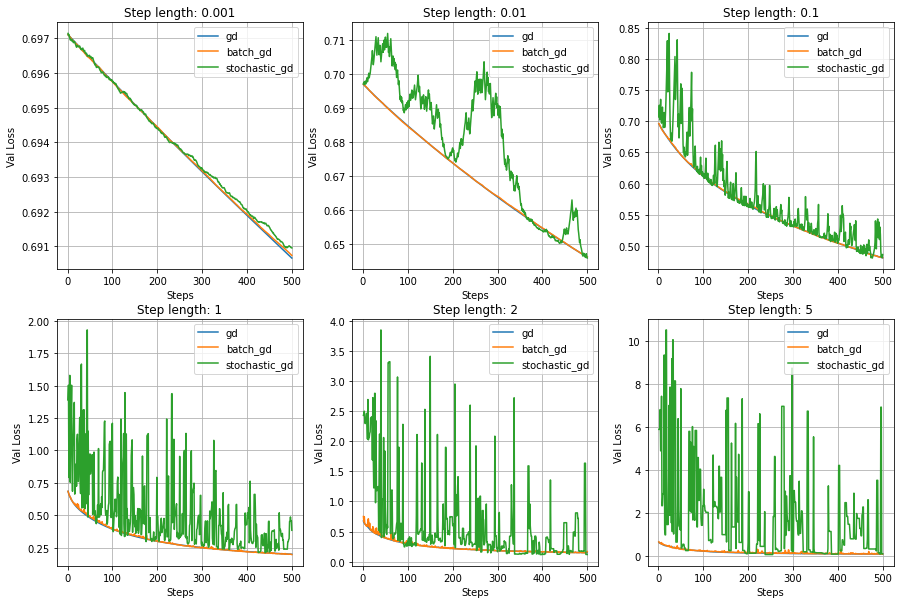

In [7]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    x = np.arange(1, 501)
    y_1 = results["val_cost"][step_length]["gd"][:500]
    y_2 = results["val_cost"][step_length]["batch_gd"][:500]
    y_3 = results["val_cost"][step_length]["stochastic_gd"][:500]
    ax.plot(x, y_1, label="gd")
    ax.plot(x, y_2, label="batch_gd")
    ax.plot(x, y_3, label="stochastic_gd")
    ax.set_xlabel("Steps")
    ax.set_ylabel("Val Loss")
    ax.grid()
    ax.legend()
    i += 1

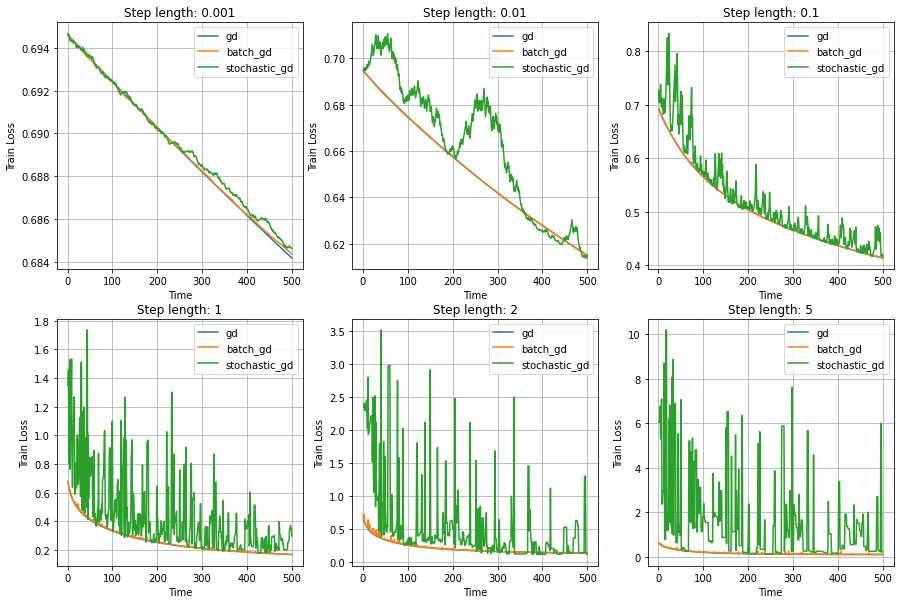

In [8]:
#plt.figure(facecolor='w')
#plt.plot(results["timestamp_epoch"]["gd"][:100], results["train_cost"]["gd"][:100], label="Gradient Descent")
#plt.plot(results["timestamp_epoch"]["batch_gd"][:500], results["train_cost"]["batch_gd"][:500], label="Batch Gradient Descent")
#plt.plot(results["timestamp_epoch"]["stochastic_gd"][:500], results["train_cost"]["stochastic_gd"][:500], label="Stochastic Gradient Descent")
#plt.xlabel("Time")
#plt.ylabel("Loss")
#plt.legend()
#plt.grid()
#plt.show()

fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["timestamp_epoch"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    x_1 = results["timestamp_epoch"][step_length]["gd"][:500]
    x_2 = results["timestamp_epoch"][step_length]["batch_gd"][:500]
    x_3 = results["timestamp_epoch"][step_length]["stochastic_gd"][:500]
    y_1 = results["train_cost"][step_length]["gd"][:500]
    y_2 = results["train_cost"][step_length]["batch_gd"][:500]
    y_3 = results["train_cost"][step_length]["stochastic_gd"][:500]
    ax.plot(x, y_1, label="gd")
    ax.plot(x, y_2, label="batch_gd")
    ax.plot(x, y_3, label="stochastic_gd")
    ax.set_xlabel("Time")
    ax.set_ylabel("Train Loss")
    ax.grid()
    ax.legend()
    i += 1

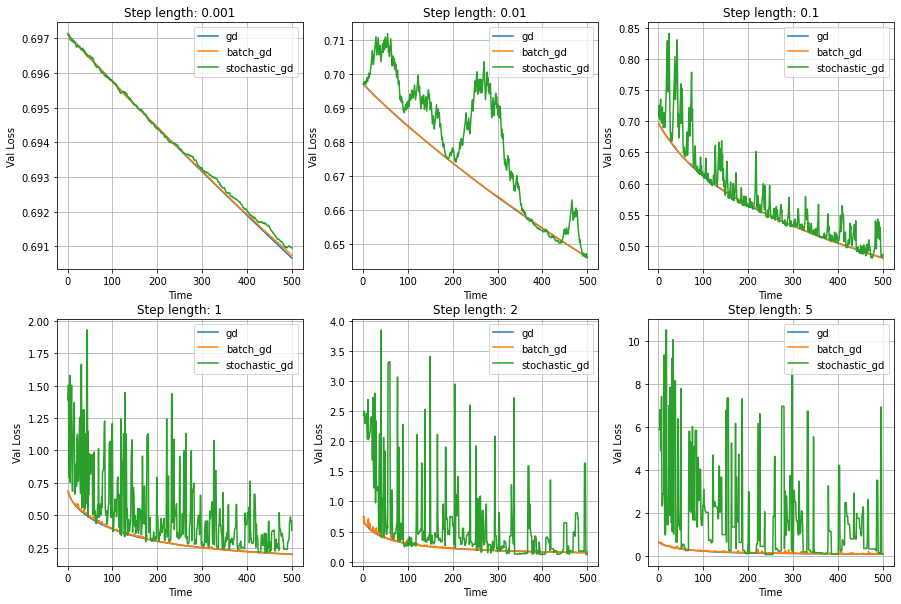

In [9]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["timestamp_epoch"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    x_1 = results["timestamp_epoch"][step_length]["gd"][:500]
    x_2 = results["timestamp_epoch"][step_length]["batch_gd"][:500]
    x_3 = results["timestamp_epoch"][step_length]["stochastic_gd"][:500]
    y_1 = results["val_cost"][step_length]["gd"][:500]
    y_2 = results["val_cost"][step_length]["batch_gd"][:500]
    y_3 = results["val_cost"][step_length]["stochastic_gd"][:500]
    ax.plot(x, y_1, label="gd")
    ax.plot(x, y_2, label="batch_gd")
    ax.plot(x, y_3, label="stochastic_gd")
    ax.set_xlabel("Time")
    ax.set_ylabel("Val Loss")
    ax.grid()
    ax.legend()
    i += 1

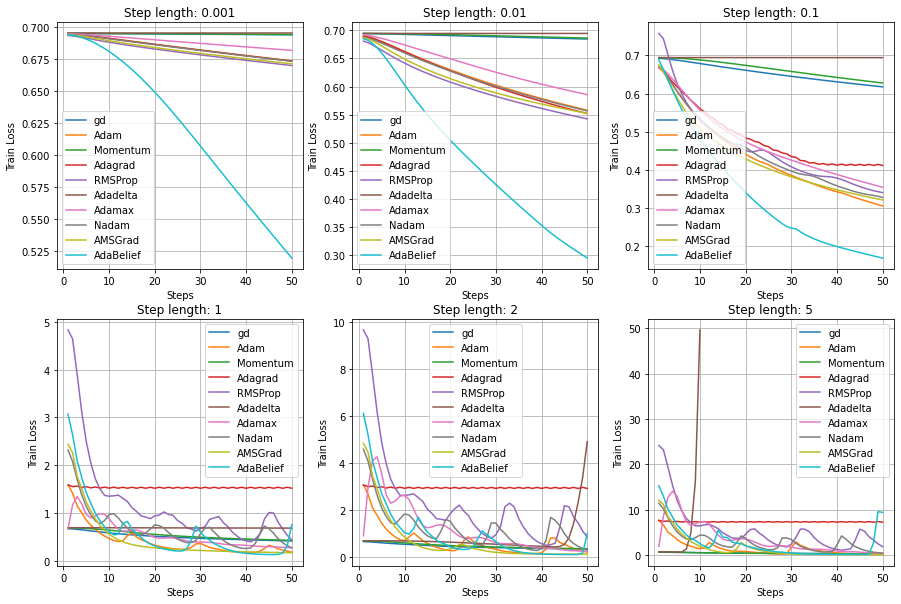

In [10]:
#plt.figure(facecolor='w')
#for optimizer in list(results["train_cost"].keys())[:10]:
#    if "Adagrad" in optimizer:
#        continue
#    y = results["train_cost"][optimizer][:50]
#    y = exponential_moving_average(y, weight=0.3)
#    plt.plot(np.arange(1, 51), y, label=optimizer)
#
#plt.legend()
#plt.grid()
#plt.xlabel("Steps")
#plt.ylabel("Loss")
#plt.show()

fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(results["train_cost"][step_length].keys())[:10]:
        try:
            x = np.arange(1, 51)
            y = results["train_cost"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Train Loss")
    ax.grid()
    ax.legend()
    i += 1

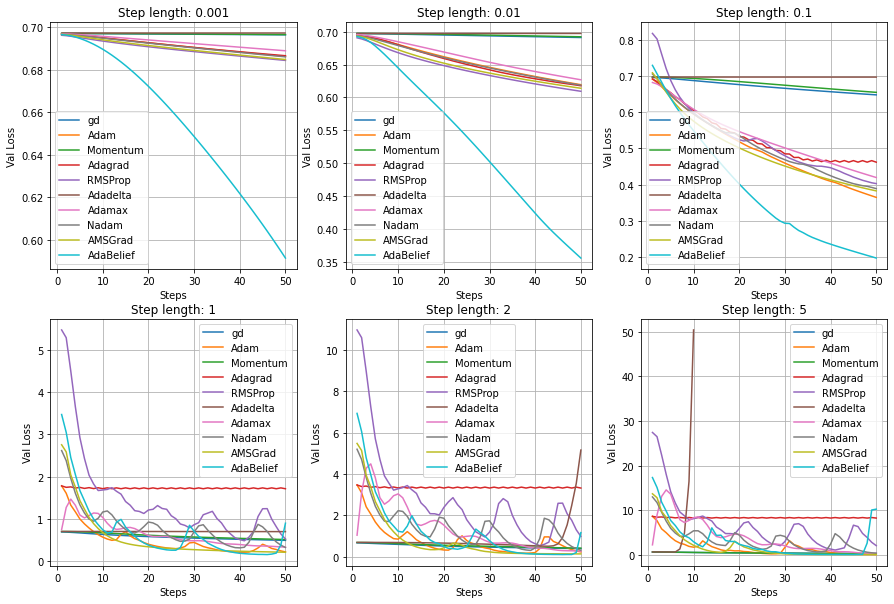

In [11]:
#plt.figure(facecolor='w')
#for optimizer in list(results["val_cost"].keys())[:10]:
#    #if "Adagrad" in optimizer:
#    #    continue
#    y = results["val_cost"][optimizer][:50]
#    y = exponential_moving_average(y, weight=0.3)
#    plt.plot(np.arange(1, 51), y, label=optimizer)
#
#plt.legend()
#plt.grid()
#plt.xlabel("Steps")
#plt.ylabel("Loss")
#plt.show()

fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["val_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["val_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(results["val_cost"][step_length].keys())[:10]:
        try:
            x = np.arange(1, 51)
            y = results["val_cost"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Val Loss")
    ax.grid()
    ax.legend()
    i += 1

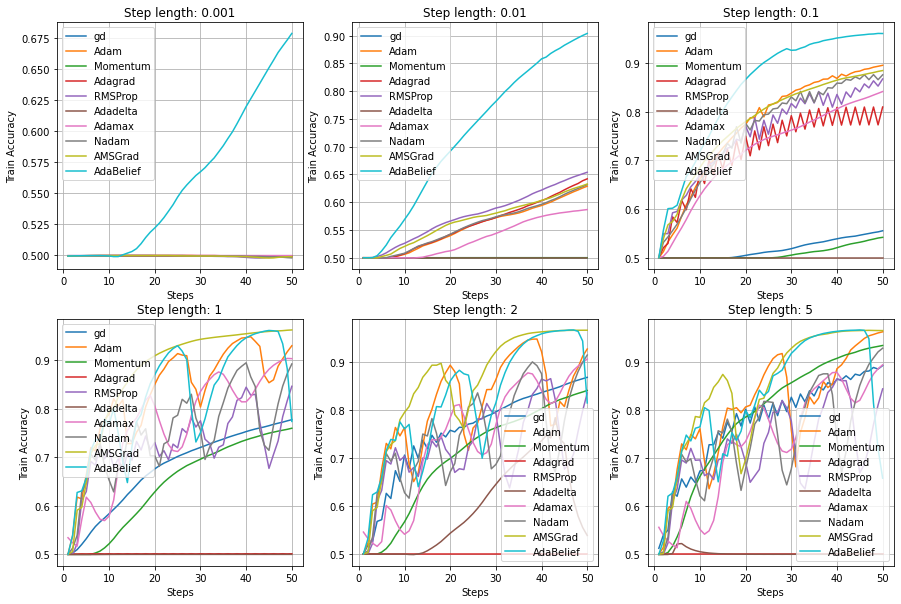

In [12]:
#plt.figure(facecolor='w')
#for optimizer in list(results["train_acc"].keys())[:10]:
#    #if "Adagrad" in optimizer:
#    #    continue
#    y = results["train_acc"][optimizer][:100]
#    y = exponential_moving_average(y, weight=0.3)
#    plt.plot(np.arange(1, 101), y, label=optimizer)
#
#plt.legend()
#plt.grid()
#plt.xlabel("Steps")
#plt.ylabel("Accuracy")
#plt.show()


fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_acc"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_acc"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(results["train_acc"][step_length].keys())[:10]:
        try:
            x = np.arange(1, 51)
            y = results["train_acc"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Train Accuracy")
    ax.grid()
    ax.legend()
    i += 1

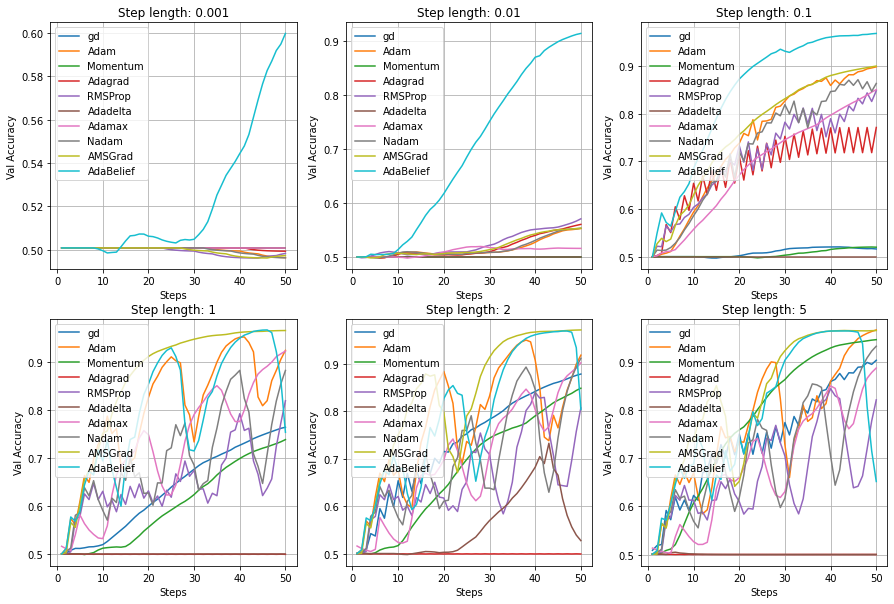

In [13]:
#plt.figure(facecolor='w')
#for optimizer in list(results["val_acc"].keys())[:10]:
#    #if "Adagrad" in optimizer:
#    #    continue
#    y = results["val_acc"][optimizer][:100]
#    y = exponential_moving_average(y, weight=0.3)
#    plt.plot(np.arange(1, 101), y, label=optimizer)
#
#plt.legend()
#plt.grid()
#plt.xlabel("Steps")
#plt.ylabel("Accuracy")
#plt.show()

fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["val_acc"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["val_acc"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(results["val_acc"][step_length].keys())[:10]:
        try:
            x = np.arange(1, 51)
            y = results["val_acc"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Val Accuracy")
    ax.grid()
    ax.legend()
    i += 1

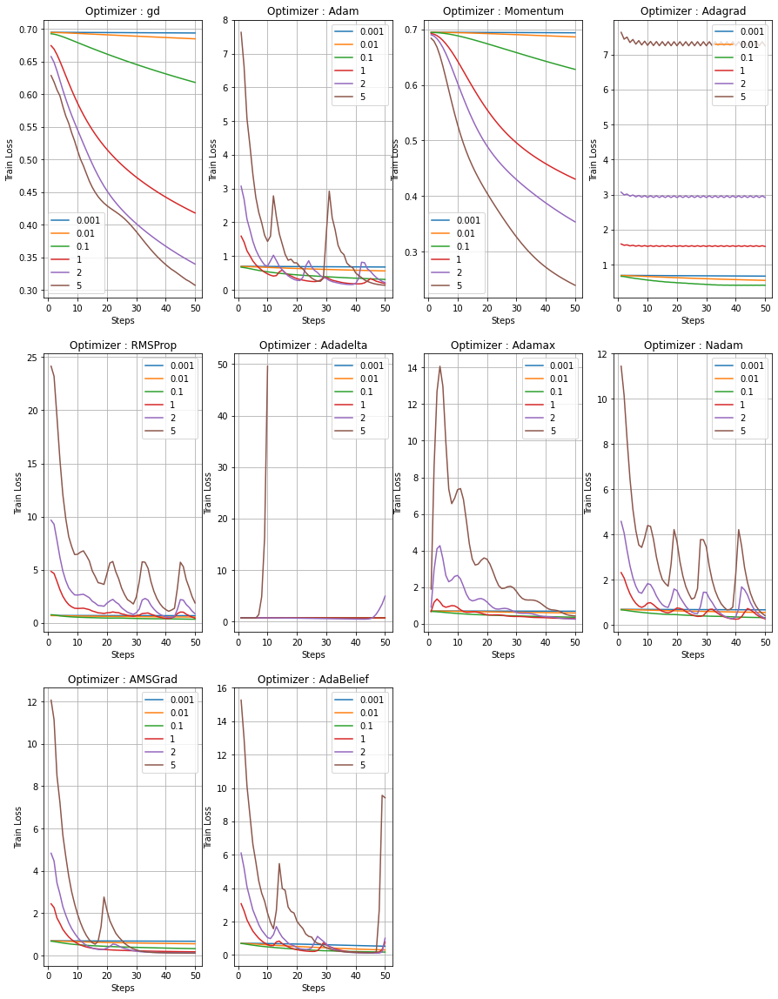

In [14]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["train_cost"][0.01].keys())[:10])
optimizers = list(results["train_cost"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    for step_length in results["train_cost"]:
        try:
            x = np.arange(1, 51)
            y = results["train_cost"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Train Loss")
    ax.grid()
    ax.legend()
    i += 1

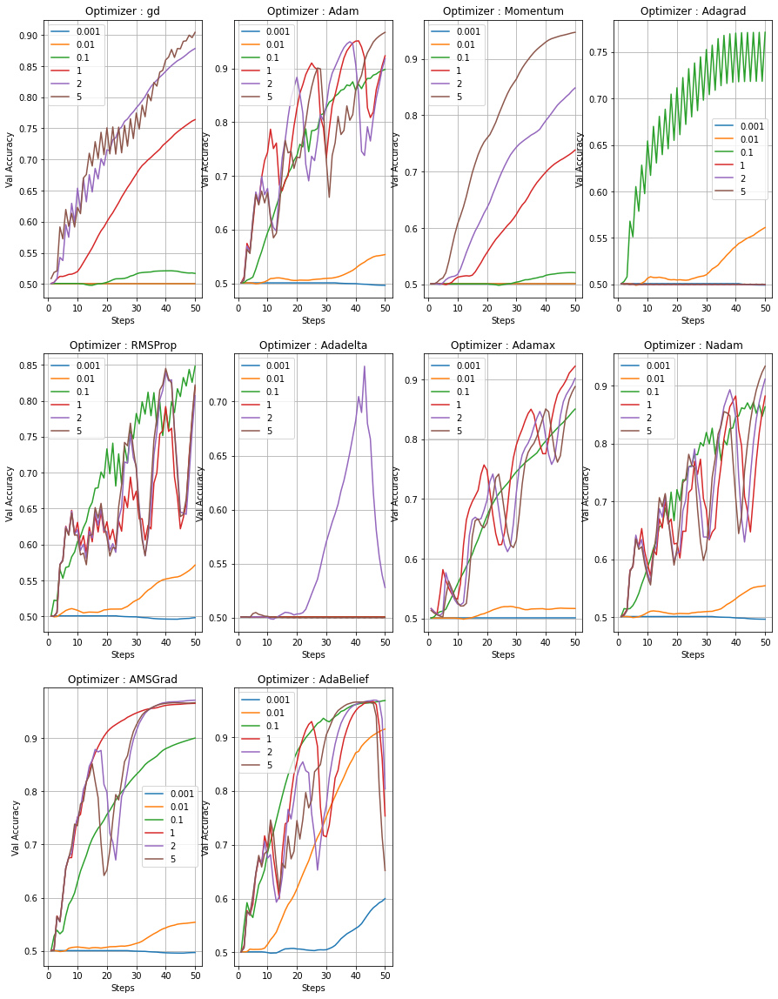

In [15]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["val_acc"][0.01].keys())[:10])
optimizers = list(results["val_acc"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    for step_length in results["val_acc"]:
        try:
            x = np.arange(1, 51)
            y = results["val_acc"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Val Accuracy")
    ax.grid()
    ax.legend()
    i += 1

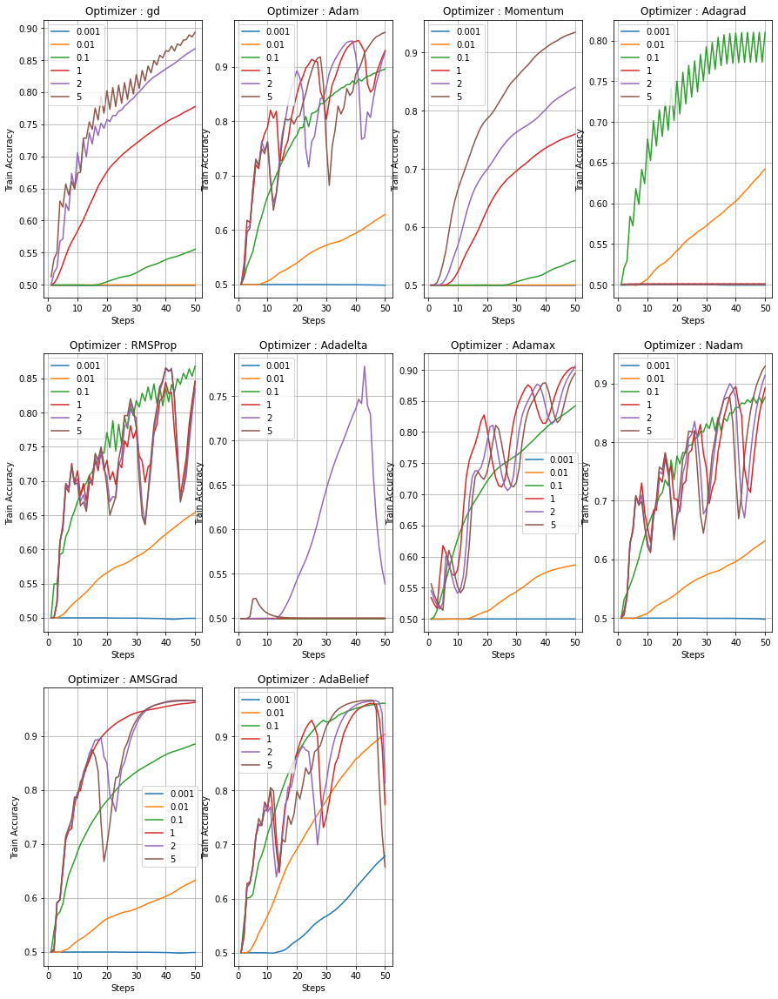

In [16]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["train_acc"][0.01].keys())[:10])
optimizers = list(results["train_acc"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    for step_length in results["train_acc"]:
        try:
            x = np.arange(1, 51)
            y = results["train_acc"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Train Accuracy")
    ax.grid()
    ax.legend()
    i += 1
    

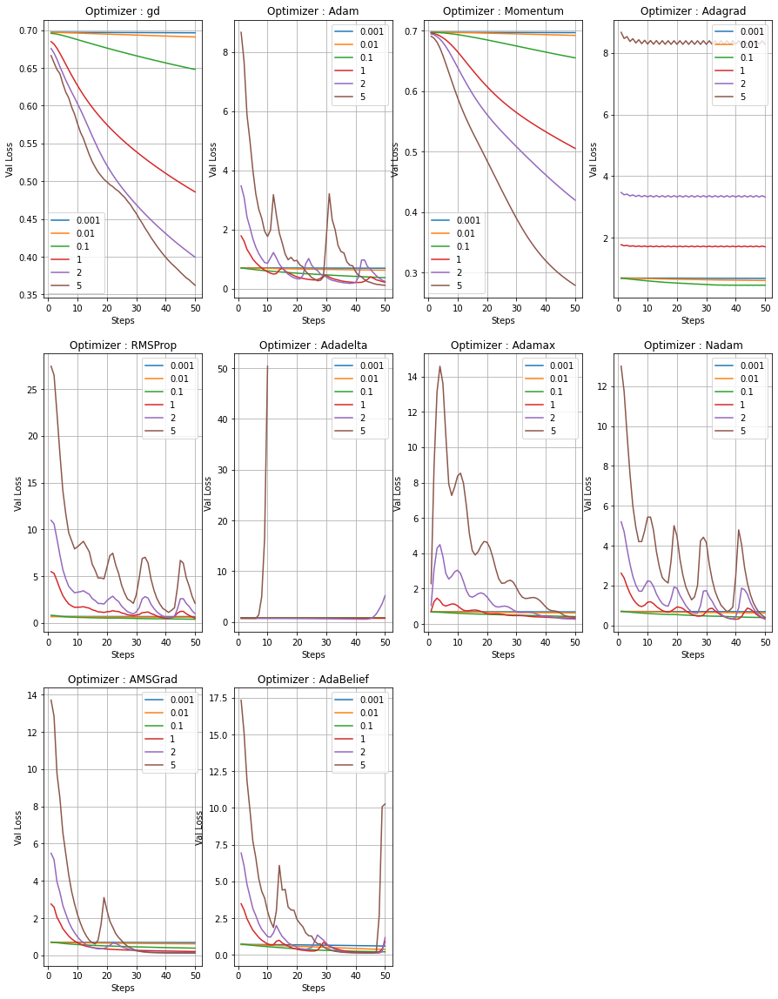

In [17]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["val_cost"][0.01].keys())[:10])
optimizers = list(results["val_cost"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    for step_length in results["val_cost"]:
        try:
            x = np.arange(1, 51)
            y = results["val_cost"][step_length][optimizer][:50]
            y = exponential_moving_average(y, weight=0.3)
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Steps")
    ax.set_ylabel("Val Loss")
    ax.grid()
    ax.legend()
    i += 1

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


0.001 [0.503821746690127, 0.09365259870982713, 0.5038419447943134, 0.09363513536620863, 0.09369986398876033, 0.693592344155114, 0.10582961420395172, 0.09367556751137678, 0.20571574826235942, 0.08892669109271419]
0.01 [0.2540252854003405, 0.0889266871242758, 0.25403031770035883, 0.09625361054069304, 0.08900048757756308, 0.6850010285333867, 0.08892665318790847, 0.08894207443809736, 0.09887775938119227, 0.08892668956255986]
0.1 [0.11094859289238355, 0.0889270219007968, 0.11093249983651611, 0.40505402552016584, 0.09076887369108871, 0.6199673283764966, 0.08892665318878511, 0.08973759331073307, 0.09092709633003772, 0.08893161931892243]
1 [0.09324927651471075, 0.08985792783733879, 0.09324865193049565, 1.4702696705700171, 0.09034406070913113, 0.09275885554125637, 0.08892665783676004, 0.08968506638860345, 0.08944904135991487, 0.09252932493689492]
2 [0.09202881376882259, 0.0947464941527926, 0.09202897702249034, 2.810801718215234, 0.10219533268576197, nan, 0.08892669476025161, 0.09501684482142532

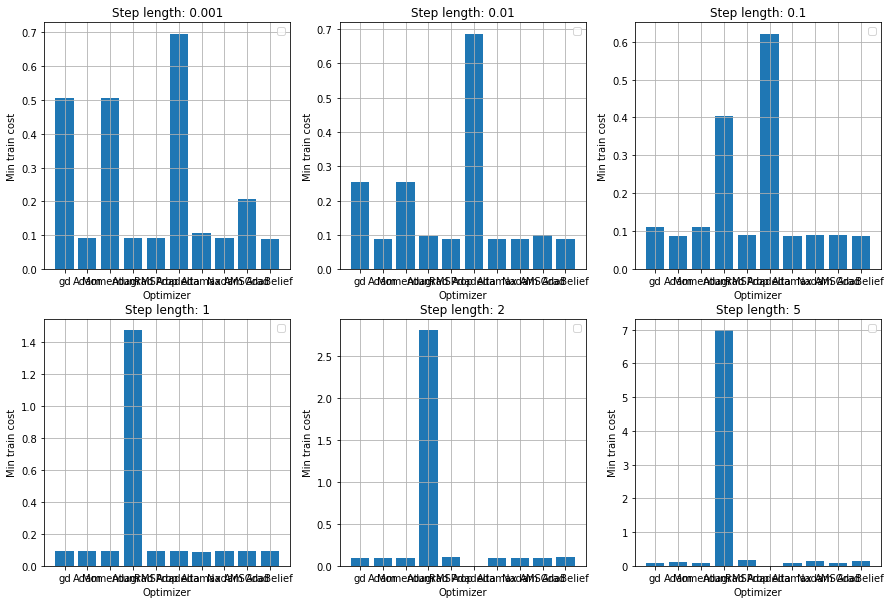

In [18]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    optimizers = []
    min_cost = []
    for optimizer in list(results["train_cost"][step_length].keys())[:10]:
        try:

            min_cost.append(np.min(results["train_cost"][step_length][optimizer]))
            optimizers.append(optimizer)
        except Exception as e:
            continue
    
    ax.bar(optimizers, min_cost)
    ax.set_xlabel("Optimizer")
    ax.set_ylabel("Min train cost")
    ax.grid()
    ax.legend()
    i += 1

    print(step_length, min_cost)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


0.001 [0.5654741386957308, 0.0952065458103434, 0.5654987383276989, 0.09491089746105819, 0.09462874244622799, 0.6965630114227395, 0.11096384897234307, 0.09492745818422993, 0.25146866776875754, 0.08479652448798636]
0.01 [0.30026194567609077, 0.0857034061931626, 0.30026599236465307, 0.09411832290401388, 0.08415093778638648, 0.692203420998056, 0.08580387074607, 0.08481953755087544, 0.10053771317585455, 0.08388083139297248]
0.1 [0.11952648247066755, 0.07838749375672402, 0.1195048349283215, 0.4523495939410763, 0.07771366559206301, 0.6542594042723432, 0.08477685290404056, 0.07978502731871094, 0.0855579058034039, 0.07766097363960324]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


1 [0.08707038663499551, 0.06771407356749337, 0.08706799503829375, 1.6624448121069277, 0.07004321533850401, 0.08850575970563405, 0.08023054349659177, 0.07360040508840968, 0.08484970066595678, 0.06579078059257834]
2 [0.08600968146550089, 0.06371374893269546, 0.08600867941673991, 3.2184364697920937, 0.06861939654847343, nan, 0.0777303448881301, 0.06997969542649517, 0.08472811864927039, 0.06940028428514301]
5 [0.08581489029999337, 0.0718476539926909, 0.08581336471320958, 7.9998976432020905, 0.0915169263651642, nan, 0.07574724467606665, 0.07533780311112286, 0.08384515361422822, 0.09675240174317834]


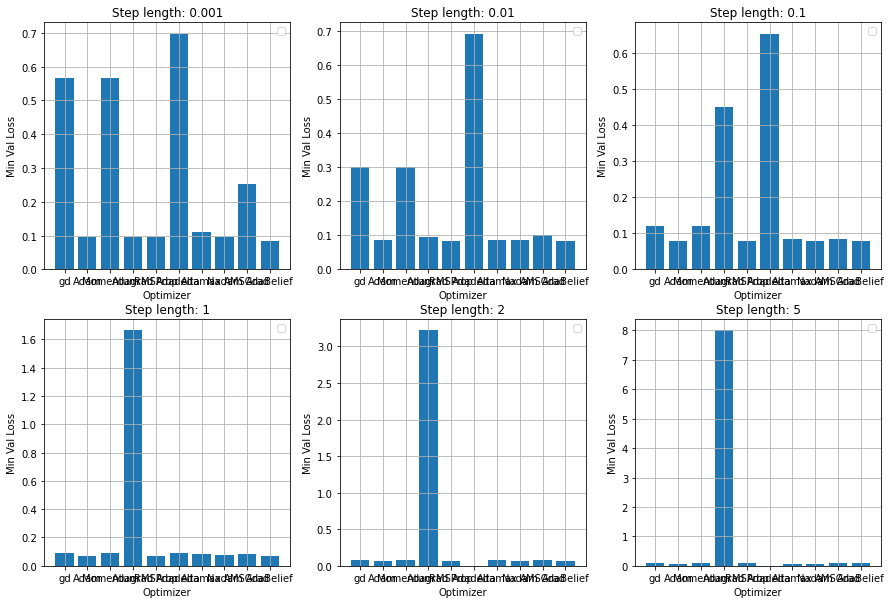

In [19]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["val_cost"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["val_cost"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    optimizers = []
    min_cost = []
    for optimizer in list(results["val_cost"][step_length].keys())[:10]:
        try:

            min_cost.append(np.min(results["val_cost"][step_length][optimizer]))
            optimizers.append(optimizer)
        except Exception as e:
            continue
    
    ax.bar(optimizers, min_cost)
    ax.set_xlabel("Optimizer")
    ax.set_ylabel("Min Val Loss")
    ax.grid()
    ax.legend()
    i += 1

    print(step_length, min_cost)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


gd [0.503821746690127, 0.2540252854003405, 0.11094859289238355, 0.09324927651471075, 0.09202881376882259, 0.09048015402903774]
Adam [0.09365259870982713, 0.0889266871242758, 0.0889270219007968, 0.08985792783733879, 0.0947464941527926, 0.11138002803682158]
Momentum [0.5038419447943134, 0.25403031770035883, 0.11093249983651611, 0.09324865193049565, 0.09202897702249034, 0.09047679400847522]
Adagrad [0.09363513536620863, 0.09625361054069304, 0.40505402552016584, 1.4702696705700171, 2.810801718215234, 6.978235492216068]
RMSProp [0.09369986398876033, 0.08900048757756308, 0.09076887369108871, 0.09034406070913113, 0.10219533268576197, 0.17198235242836177]
Adadelta [0.693592344155114, 0.6850010285333867, 0.6199673283764966, 0.09275885554125637, nan, nan]
Adamax [0.10582961420395172, 0.08892665318790847, 0.08892665318878511, 0.08892665783676004, 0.08892669476025161, 0.08892912680504268]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


Nadam [0.09367556751137678, 0.08894207443809736, 0.08973759331073307, 0.08968506638860345, 0.09501684482142532, 0.1354569940708509]
AMSGrad [0.20571574826235942, 0.09887775938119227, 0.09092709633003772, 0.08944904135991487, 0.08903375958327746, 0.08892975157593574]
AdaBelief [0.08892669109271419, 0.08892668956255986, 0.08893161931892243, 0.09252932493689492, 0.10063321323406922, 0.1321854186568046]


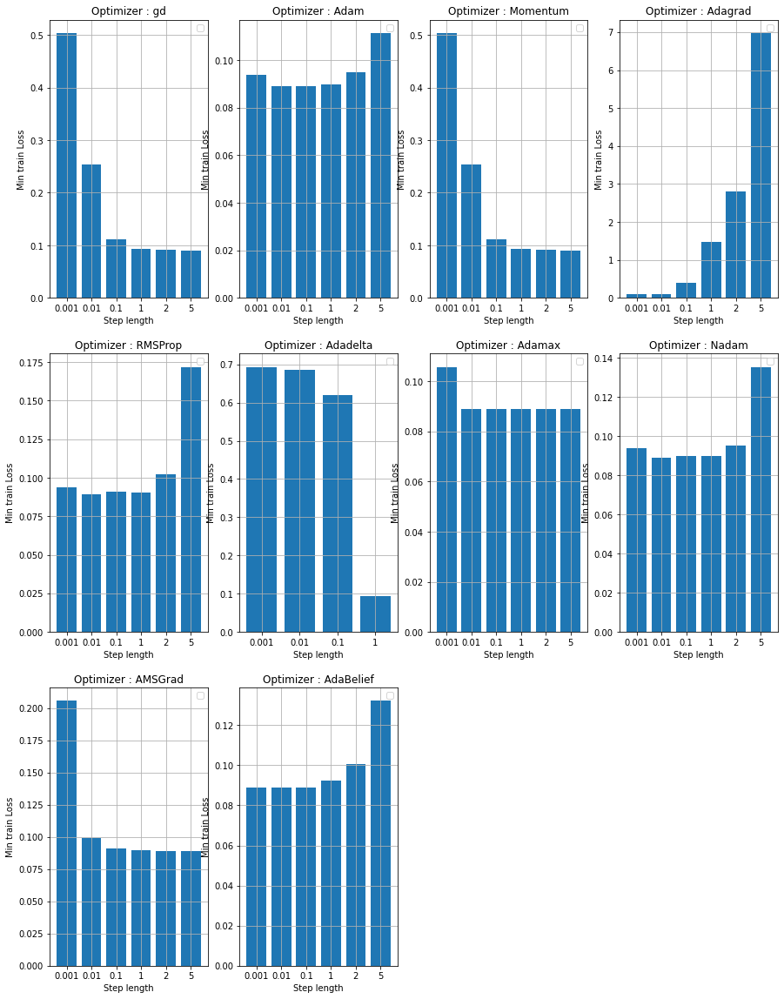

In [20]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["train_cost"][0.01].keys())[:10])
optimizers = list(results["train_cost"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    steps = []
    min_cost = []
    for step_length in results["train_cost"]:
        try:
            min_cost.append(np.min(results["train_cost"][step_length][optimizer]))
            steps.append(str(step_length))
        except Exception as e:
            print("Exception {}".format(e))
            continue
    
    ax.bar(steps, min_cost)
    ax.set_xlabel("Step length")
    ax.set_ylabel("Min train Loss")
    ax.grid()
    ax.legend()
    i += 1

    print(optimizer, min_cost)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


gd [0.5654741386957308, 0.30026194567609077, 0.11952648247066755, 0.08707038663499551, 0.08600968146550089, 0.08581489029999337]
Adam [0.0952065458103434, 0.0857034061931626, 0.07838749375672402, 0.06771407356749337, 0.06371374893269546, 0.0718476539926909]
Momentum [0.5654987383276989, 0.30026599236465307, 0.1195048349283215, 0.08706799503829375, 0.08600867941673991, 0.08581336471320958]
Adagrad [0.09491089746105819, 0.09411832290401388, 0.4523495939410763, 1.6624448121069277, 3.2184364697920937, 7.9998976432020905]
RMSProp [0.09462874244622799, 0.08415093778638648, 0.07771366559206301, 0.07004321533850401, 0.06861939654847343, 0.0915169263651642]
Adadelta [0.6965630114227395, 0.692203420998056, 0.6542594042723432, 0.08850575970563405, nan, nan]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


Adamax [0.11096384897234307, 0.08580387074607, 0.08477685290404056, 0.08023054349659177, 0.0777303448881301, 0.07574724467606665]
Nadam [0.09492745818422993, 0.08481953755087544, 0.07978502731871094, 0.07360040508840968, 0.06997969542649517, 0.07533780311112286]
AMSGrad [0.25146866776875754, 0.10053771317585455, 0.0855579058034039, 0.08484970066595678, 0.08472811864927039, 0.08384515361422822]
AdaBelief [0.08479652448798636, 0.08388083139297248, 0.07766097363960324, 0.06579078059257834, 0.06940028428514301, 0.09675240174317834]


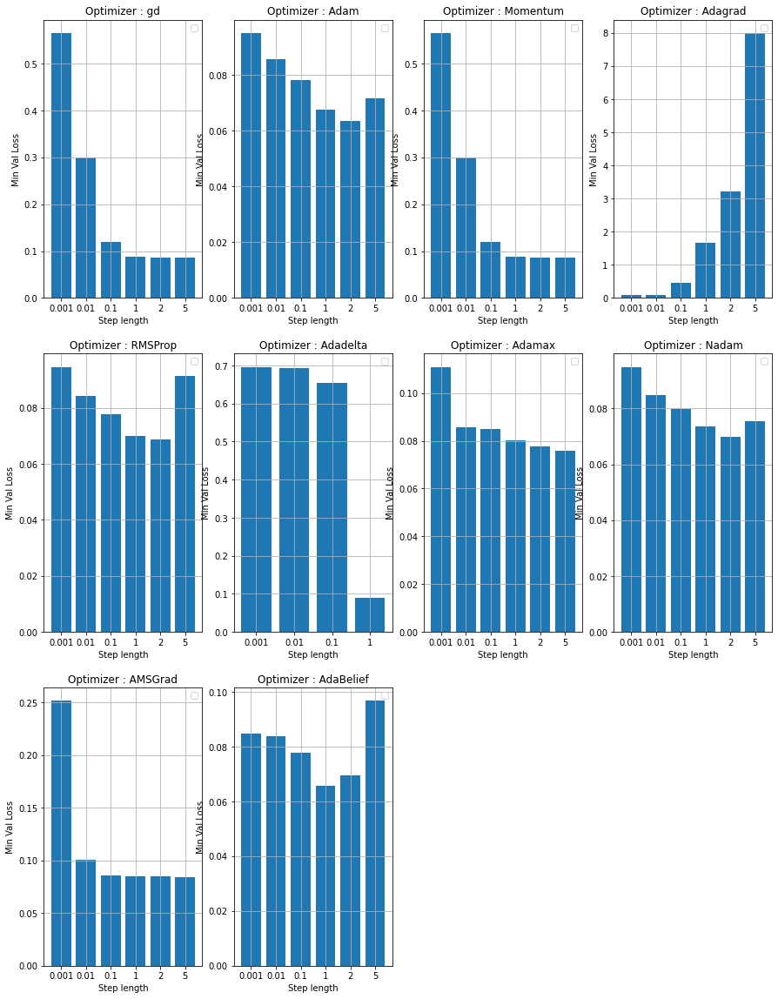

In [21]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["val_cost"][0.01].keys())[:10])
optimizers = list(results["val_cost"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    steps = []
    min_cost = []
    for step_length in results["val_cost"]:
        try:
            min_cost.append(np.min(results["val_cost"][step_length][optimizer]))
            steps.append(str(step_length))
        except Exception as e:
            print("Exception {}".format(e))
            continue
    
    ax.bar(steps, min_cost)
    ax.set_xlabel("Step length")
    ax.set_ylabel("Min Val Loss")
    ax.grid()
    ax.legend()
    i += 1

    print(optimizer, min_cost)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


0.001 [0.6923076923076923, 0.9719921104536489, 0.6923076923076923, 0.9715976331360947, 0.9719921104536489, 0.49940828402366866, 0.9719921104536489, 0.9719921104536489, 0.9562130177514793, 0.9747534516765286]
0.01 [0.9325443786982248, 0.9735700197238659, 0.9325443786982248, 0.9712031558185404, 0.9739644970414201, 0.49980276134122287, 0.9747534516765286, 0.9735700197238659, 0.9727810650887574, 0.9747534516765286]
0.1 [0.9715976331360947, 0.9755424063116371, 0.9715976331360947, 0.8962524654832347, 0.9751479289940829, 0.545956607495069, 0.9751479289940829, 0.9747534516765286, 0.9747534516765286, 0.9751479289940829]
1 [0.9735700197238659, 0.9751479289940829, 0.9735700197238659, 0.5017751479289941, 0.9755424063116371, 0.9723865877712031, 0.9751479289940829, 0.9751479289940829, 0.9739644970414201, 0.9751479289940829]


No handles with labels found to put in legend.


2 [0.9747534516765286, 0.9747534516765286, 0.9747534516765286, 0.5001972386587771, 0.9747534516765286, 0.8816568047337278, 0.9751479289940829, 0.9755424063116371, 0.9739644970414201, 0.9735700197238659]
5 [0.9747534516765286, 0.9739644970414201, 0.9747534516765286, 0.5001972386587771, 0.9731755424063117, 0.5680473372781065, 0.9755424063116371, 0.9735700197238659, 0.9743589743589743, 0.9735700197238659]


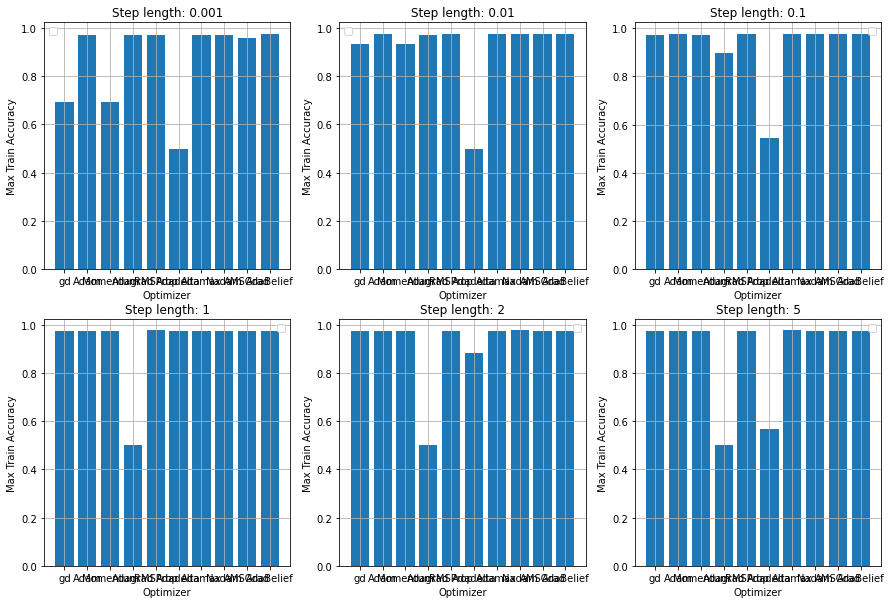

In [22]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["train_acc"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["train_acc"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    optimizers = []
    max_acc = []
    for optimizer in list(results["train_acc"][step_length].keys())[:10]:
        try:

            max_acc.append(np.max(results["train_acc"][step_length][optimizer]))
            optimizers.append(optimizer)
        except Exception as e:
            continue
    
    ax.bar(optimizers, max_acc)
    ax.set_xlabel("Optimizer")
    ax.set_ylabel("Max Train Accuracy")
    ax.grid()
    ax.legend()
    i += 1

    print(step_length, max_acc)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


0.001 [0.617693522906793, 0.976303317535545, 0.617693522906793, 0.976303317535545, 0.976303317535545, 0.5007898894154819, 0.9747235387045814, 0.976303317535545, 0.9605055292259084, 0.9747235387045814]
0.01 [0.9447077409162717, 0.976303317535545, 0.9447077409162717, 0.9794628751974723, 0.976303317535545, 0.5007898894154819, 0.9747235387045814, 0.976303317535545, 0.976303317535545, 0.976303317535545]
0.1 [0.9747235387045814, 0.9794628751974723, 0.9747235387045814, 0.8941548183254344, 0.9778830963665087, 0.5150078988941548, 0.9747235387045814, 0.976303317535545, 0.9747235387045814, 0.9778830963665087]
1 [0.9747235387045814, 0.9794628751974723, 0.9747235387045814, 0.5007898894154819, 0.9778830963665087, 0.976303317535545, 0.976303317535545, 0.9778830963665087, 0.9747235387045814, 0.9778830963665087]


No handles with labels found to put in legend.


2 [0.9747235387045814, 0.9778830963665087, 0.9747235387045814, 0.5007898894154819, 0.9778830963665087, 0.8325434439178515, 0.9778830963665087, 0.976303317535545, 0.9747235387045814, 0.976303317535545]
5 [0.976303317535545, 0.9794628751974723, 0.9747235387045814, 0.5007898894154819, 0.9747235387045814, 0.5118483412322274, 0.9794628751974723, 0.976303317535545, 0.9747235387045814, 0.976303317535545]


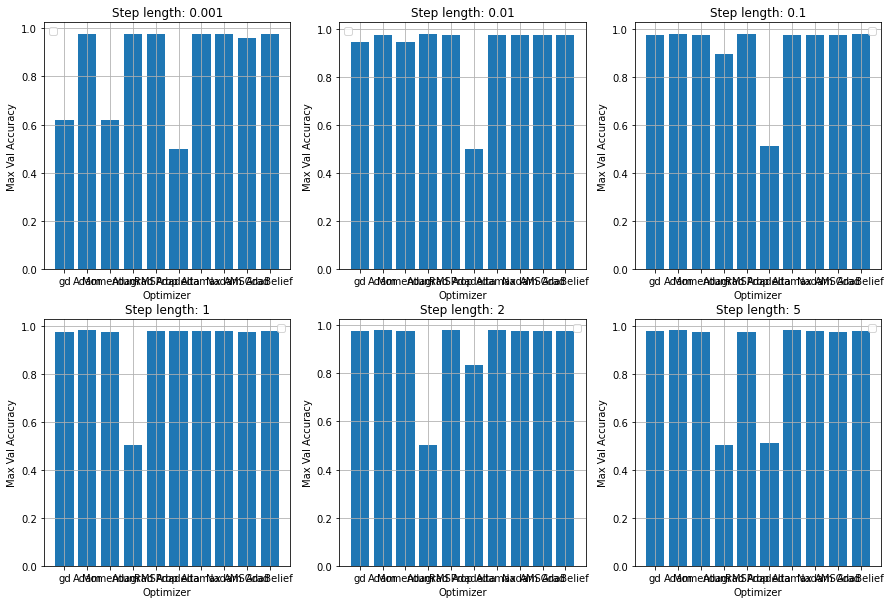

In [23]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(results["val_acc"].keys())
cols = 3
rows = math.ceil(nums/cols)
i = 0
for step_length in results["val_acc"]:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    optimizers = []
    max_acc = []
    for optimizer in list(results["val_acc"][step_length].keys())[:10]:
        try:

            max_acc.append(np.max(results["val_acc"][step_length][optimizer]))
            optimizers.append(optimizer)
        except Exception as e:
            continue
    
    ax.bar(optimizers, max_acc)
    ax.set_xlabel("Optimizer")
    ax.set_ylabel("Max Val Accuracy")
    ax.grid()
    ax.legend()
    i += 1

    print(step_length, max_acc)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


gd [0.6923076923076923, 0.9325443786982248, 0.9715976331360947, 0.9735700197238659, 0.9747534516765286, 0.9747534516765286]
Adam [0.9719921104536489, 0.9735700197238659, 0.9755424063116371, 0.9751479289940829, 0.9747534516765286, 0.9739644970414201]
Momentum [0.6923076923076923, 0.9325443786982248, 0.9715976331360947, 0.9735700197238659, 0.9747534516765286, 0.9747534516765286]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


Adagrad [0.9715976331360947, 0.9712031558185404, 0.8962524654832347, 0.5017751479289941, 0.5001972386587771, 0.5001972386587771]
RMSProp [0.9719921104536489, 0.9739644970414201, 0.9751479289940829, 0.9755424063116371, 0.9747534516765286, 0.9731755424063117]
Adadelta [0.49940828402366866, 0.49980276134122287, 0.545956607495069, 0.9723865877712031, 0.8816568047337278, 0.5680473372781065]
Adamax [0.9719921104536489, 0.9747534516765286, 0.9751479289940829, 0.9751479289940829, 0.9751479289940829, 0.9755424063116371]
Nadam [0.9719921104536489, 0.9735700197238659, 0.9747534516765286, 0.9751479289940829, 0.9755424063116371, 0.9735700197238659]
AMSGrad [0.9562130177514793, 0.9727810650887574, 0.9747534516765286, 0.9739644970414201, 0.9739644970414201, 0.9743589743589743]
AdaBelief [0.9747534516765286, 0.9747534516765286, 0.9751479289940829, 0.9751479289940829, 0.9735700197238659, 0.9735700197238659]


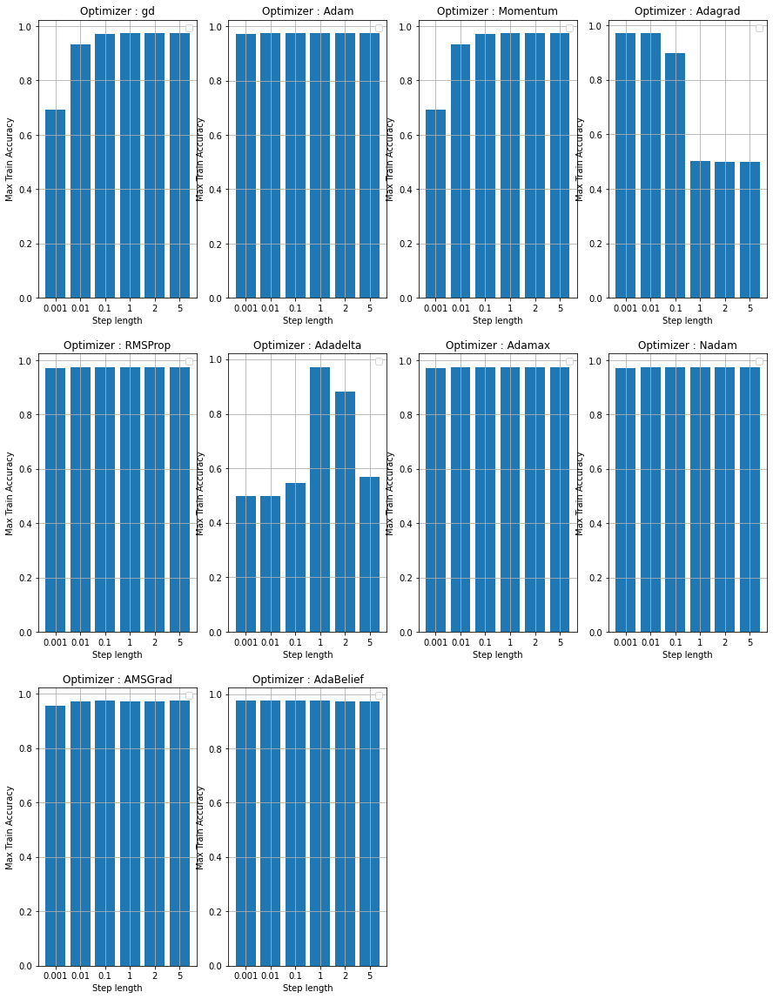

In [24]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["train_acc"][0.01].keys())[:10])
optimizers = list(results["train_acc"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    steps = []
    max_acc = []
    for step_length in results["train_acc"]:
        try:
            max_acc.append(np.max(results["train_acc"][step_length][optimizer]))
            steps.append(str(step_length))
        except Exception as e:
            print("Exception {}".format(e))
            continue
    
    ax.bar(steps, max_acc)
    ax.set_xlabel("Step length")
    ax.set_ylabel("Max Train Accuracy")
    ax.grid()
    ax.legend()
    i += 1

    print(optimizer, max_acc)

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


gd [0.617693522906793, 0.9447077409162717, 0.9747235387045814, 0.9747235387045814, 0.9747235387045814, 0.976303317535545]
Adam [0.976303317535545, 0.976303317535545, 0.9794628751974723, 0.9794628751974723, 0.9778830963665087, 0.9794628751974723]
Momentum [0.617693522906793, 0.9447077409162717, 0.9747235387045814, 0.9747235387045814, 0.9747235387045814, 0.9747235387045814]
Adagrad [0.976303317535545, 0.9794628751974723, 0.8941548183254344, 0.5007898894154819, 0.5007898894154819, 0.5007898894154819]
RMSProp [0.976303317535545, 0.976303317535545, 0.9778830963665087, 0.9778830963665087, 0.9778830963665087, 0.9747235387045814]
Adadelta [0.5007898894154819, 0.5007898894154819, 0.5150078988941548, 0.976303317535545, 0.8325434439178515, 0.5118483412322274]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


Adamax [0.9747235387045814, 0.9747235387045814, 0.9747235387045814, 0.976303317535545, 0.9778830963665087, 0.9794628751974723]
Nadam [0.976303317535545, 0.976303317535545, 0.976303317535545, 0.9778830963665087, 0.976303317535545, 0.976303317535545]
AMSGrad [0.9605055292259084, 0.976303317535545, 0.9747235387045814, 0.9747235387045814, 0.9747235387045814, 0.9747235387045814]
AdaBelief [0.9747235387045814, 0.976303317535545, 0.9778830963665087, 0.9778830963665087, 0.976303317535545, 0.976303317535545]


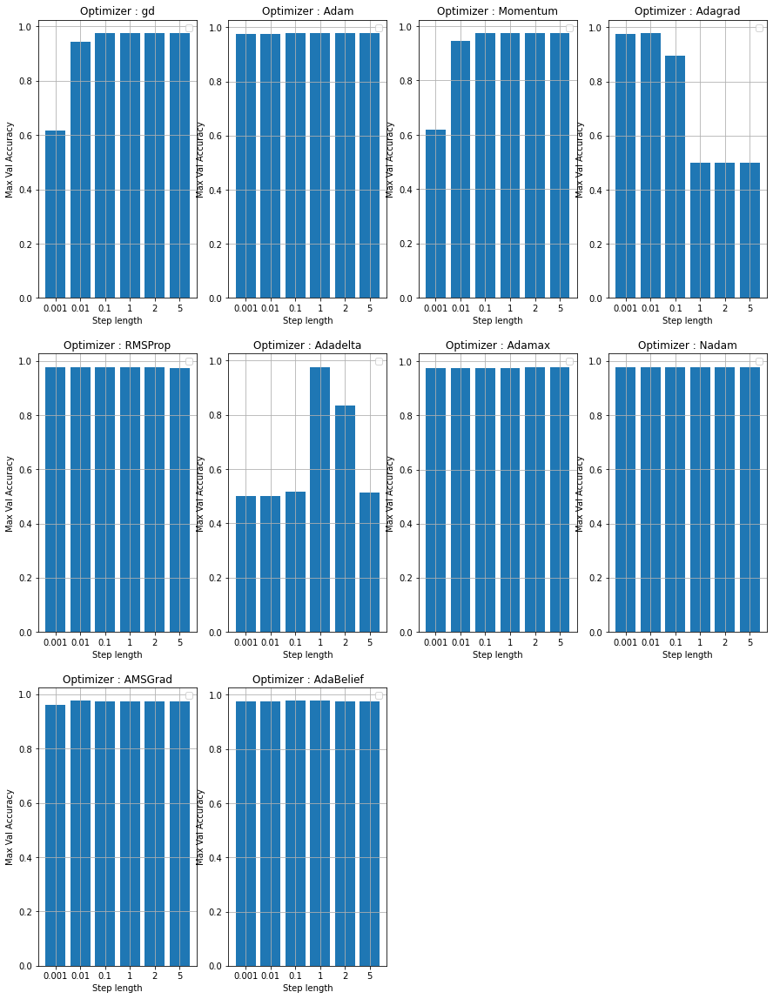

In [25]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(list(results["val_acc"][0.01].keys())[:10])
optimizers = list(results["val_acc"][0.01].keys())[:10]

cols = 4
rows = math.ceil(nums/cols)

i = 0
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer : {}".format(optimizer))
    steps = []
    max_acc = []
    for step_length in results["val_acc"]:
        try:
            max_acc.append(np.max(results["val_acc"][step_length][optimizer]))
            steps.append(str(step_length))
        except Exception as e:
            print("Exception {}".format(e))
            continue
    
    ax.bar(steps, max_acc)
    ax.set_xlabel("Step length")
    ax.set_ylabel("Max Val Accuracy")
    ax.grid()
    ax.legend()
    i += 1

    print(optimizer, max_acc)

In [26]:
x_train = np.load("x_train.npy")
y_train = np.load("y_train.npy")
x_val = np.load("x_val.npy")
y_val = np.load("y_val.npy")

x_train.shape, y_train.shape, x_val.shape, y_val.shape

((2535, 16), (2535,), (633, 16), (633,))

In [27]:

min_val_cost_prob = {}
max_val_acc_prob = {}

for step_length in results["min_val_cost_weights"]:
    min_val_cost_prob[step_length] = {}
    for optimizer in list(results["min_val_cost_weights"][step_length].keys())[:10]:
        try:
            weights = results["min_val_cost_weights"][step_length][optimizer]
            min_val_cost_prob[step_length][optimizer] = predict(x=x_val, w=weights, return_prob=True)
        except Exception as e:
            print("Exception {}".format(e))

#for step_length in results["max_val_acc_weights"]:
#    max_val_acc_prob[step_length] = {}
#    for optimizer in results["max_val_acc_weights"][step_length]:
#        try:
#            weights = results["max_val_acc_weights"][step_length][optimizer]
#            max_val_acc_prob[step_length][optimizer] = predict(x=x_val, w=weights, return_prob=True)
#        except Exception as e:
#            print("Exception {}".format(e))



In [28]:
precisions = {}
recalls = {}
fpr = {}
tpr = {}


for step_length in min_val_cost_prob:
    precisions[step_length] = {}
    recalls[step_length] = {}
    fpr[step_length] = {}
    tpr[step_length] = {}
    for optimizer in min_val_cost_prob[step_length]:
        precisions[step_length][optimizer], recalls[step_length][optimizer], _ = precision_recall_curve(y_val, min_val_cost_prob[step_length][optimizer])
        #print(min_val_cost_prob[step_length][optimizer].shape)
        fpr[step_length][optimizer], tpr[step_length][optimizer], _ = roc_curve(y_val, min_val_cost_prob[step_length][optimizer])

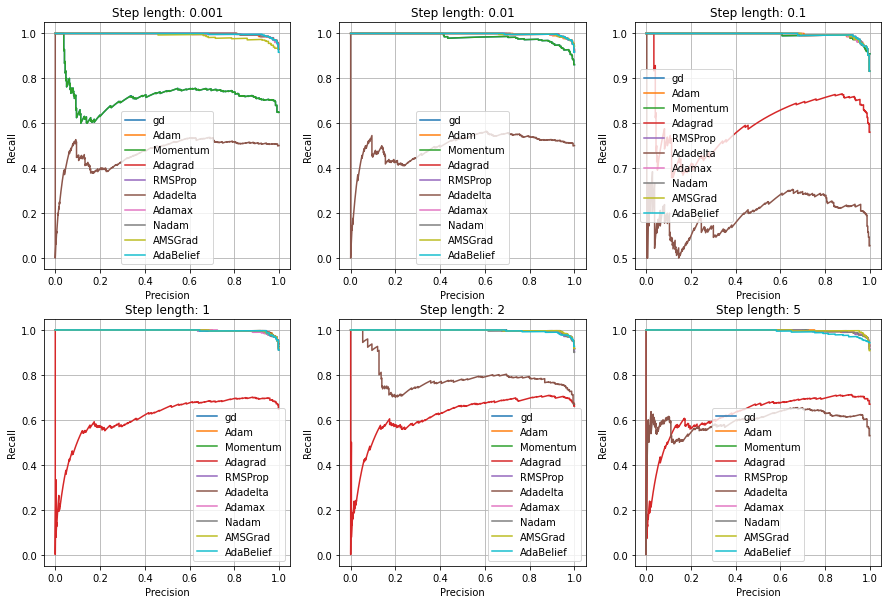

In [29]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(precisions.keys())
cols = 3

rows = math.ceil(nums/cols)
i = 0
for step_length in precisions:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(precisions[step_length].keys()):
        try:
            x = recalls[step_length][optimizer]
            y = precisions[step_length][optimizer]
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Precision")
    ax.set_ylabel("Recall")
    ax.grid()
    ax.legend()
    i += 1

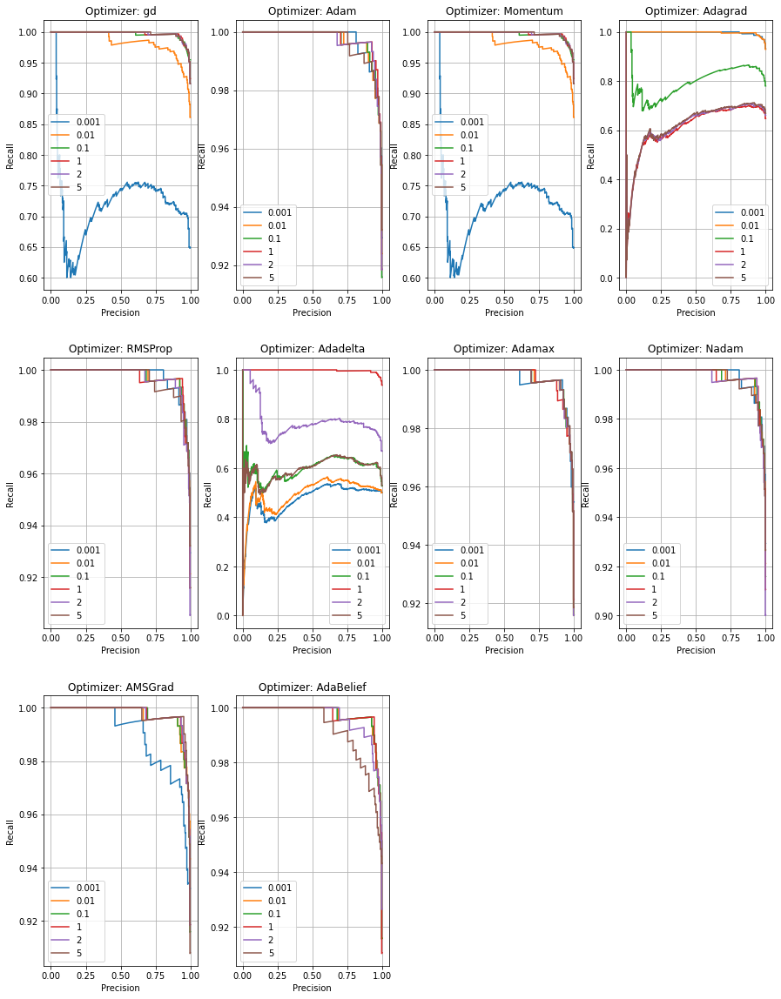

In [30]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.25, hspace=0.25)
nums = len(precisions[0.01].keys())
cols = 4

rows = math.ceil(nums/cols)
i = 0
optimizers = list(precisions[0.01].keys())
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer: {}".format(optimizer))
    for step_length in precisions.keys():
        try:
            x = recalls[step_length][optimizer]
            y = precisions[step_length][optimizer]
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("Precision")
    ax.set_ylabel("Recall")
    ax.grid()
    ax.legend()
    i += 1

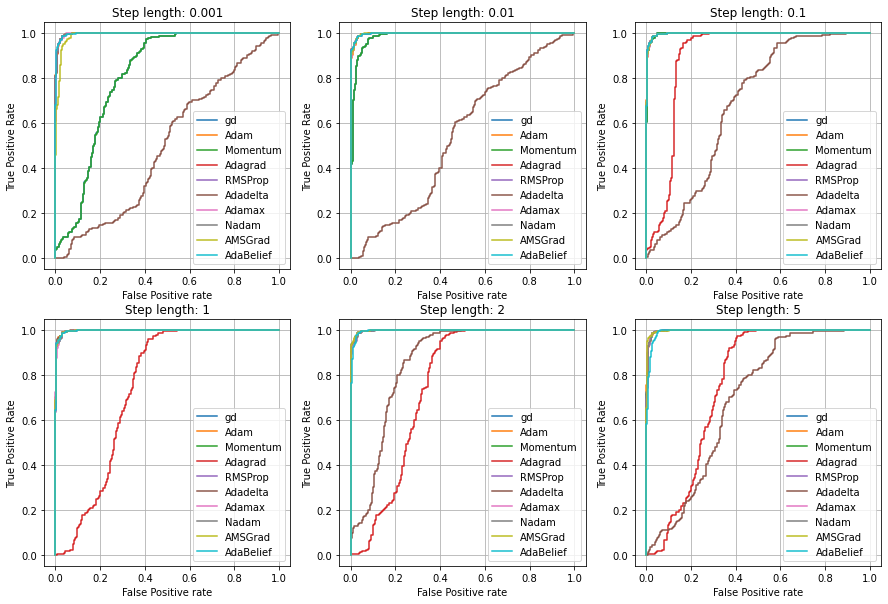

In [31]:
fig = plt.figure(figsize=(15, 10), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
nums = len(tpr.keys())
cols = 3

rows = math.ceil(nums/cols)
i = 0
for step_length in tpr:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Step length: {}".format(step_length))
    for optimizer in list(tpr[step_length].keys()):
        try:
            x = fpr[step_length][optimizer]
            y = tpr[step_length][optimizer]
            ax.plot(x, y, label=optimizer)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("False Positive rate")
    ax.set_ylabel("True Positive Rate")
    ax.grid()
    ax.legend()
    i += 1

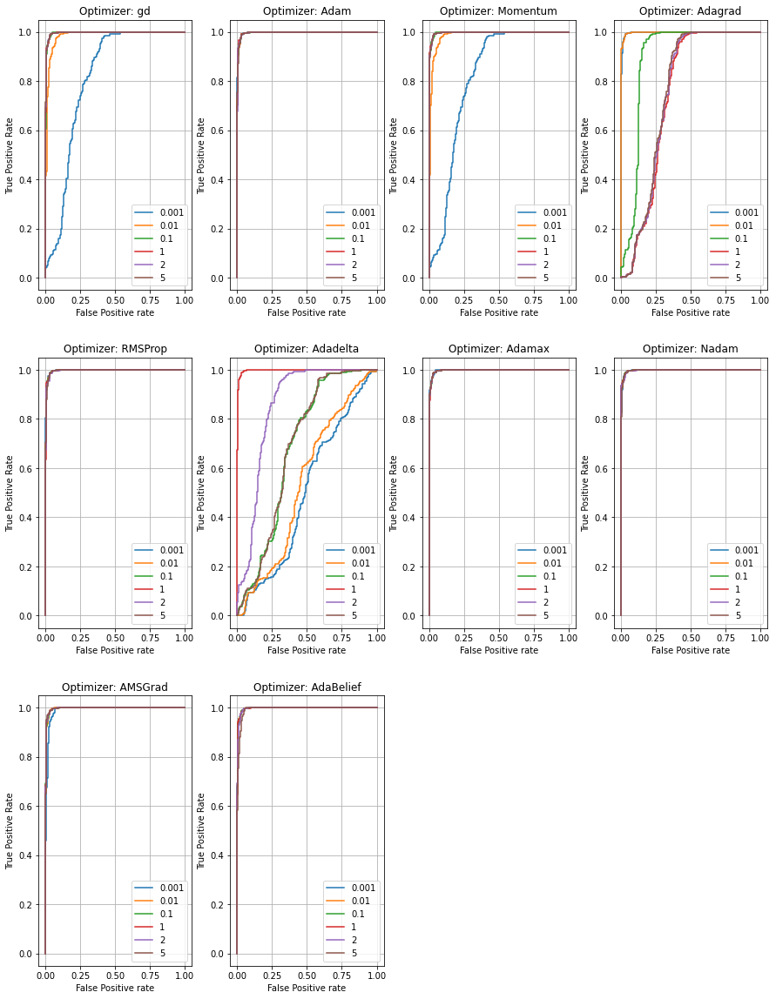

In [32]:
fig = plt.figure(figsize=(15, 20), facecolor='w')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.25, hspace=0.25)
nums = len(tpr[0.01].keys())
cols = 4

rows = math.ceil(nums/cols)
i = 0
optimizers = list(tpr[0.01].keys())
for optimizer in optimizers:
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title("Optimizer: {}".format(optimizer))
    for step_length in tpr.keys():
        try:
            x = fpr[step_length][optimizer]
            y = tpr[step_length][optimizer]
            ax.plot(x, y, label=step_length)
        except Exception as e:
            print("Exception {}".format(e))
            continue

    ax.set_xlabel("False Positive rate")
    ax.set_ylabel("True Positive Rate")
    ax.grid()
    ax.legend()
    i += 1

In [33]:
wolfe_II_ratio = {}
goldstein_ratio = {}

for step_length in results["wolf_II"]:
    wolfe_II_ratio[step_length] = {}
    goldstein_ratio[step_length] = {}
    for optimizer in results["wolf_II"][step_length]:
        wolfe_II_ratio[step_length][optimizer] = np.sum(np.array(results["wolf_II"][step_length][optimizer])) / np.array(results["wolf_II"][step_length][optimizer]).shape[0]
        goldstein_ratio[step_length][optimizer] = np.sum(np.array(results["goldstein"][step_length][optimizer])) / np.array(results["goldstein"][step_length][optimizer]).shape[0]

In [34]:
wolfe_II_ratio

{0.001: {'gd': 0.0, 'batch_gd': 0.0, 'stochastic_gd': 0.0},
 0.01: {'gd': 0.0, 'batch_gd': 0.0, 'stochastic_gd': 0.0},
 0.1: {'gd': 0.0, 'batch_gd': 0.0003, 'stochastic_gd': 0.1227},
 1: {'gd': 5e-05, 'batch_gd': 0.6725, 'stochastic_gd': 0.25345},
 2: {'gd': 0.00125, 'batch_gd': 0.8586, 'stochastic_gd': 0.19155},
 5: {'gd': 0.00925, 'batch_gd': 0.9322, 'stochastic_gd': 0.1965}}

In [35]:
goldstein_ratio

{0.001: {'gd': 0.0, 'batch_gd': 0.0, 'stochastic_gd': 0.0},
 0.01: {'gd': 0.0, 'batch_gd': 0.0, 'stochastic_gd': 0.0},
 0.1: {'gd': 0.0, 'batch_gd': 0.0, 'stochastic_gd': 0.0},
 1: {'gd': 0.0, 'batch_gd': 0.009, 'stochastic_gd': 0.1104},
 2: {'gd': 0.0005, 'batch_gd': 0.0304, 'stochastic_gd': 0.10175},
 5: {'gd': 0.00425, 'batch_gd': 0.53255, 'stochastic_gd': 0.1337}}